# RAS 557 - Assignment 5 - Parameter Identification

### Vamshi Narayana Babu
### ASU ID : 1234232638

## Data Collection Setup and Steps


* Setup. SG90 servo with a cylindrical “battery” load; rig placed on a table and weighted down to suppress base motion.

* Camera. Phone on a fixed stand 12 in from the link CoM; optical axis normal to the motion plane.

* Wiring. Battery mass measured and attached to the horn using wires (minimal compliance).

* Command. Square-wave position command (A, f, w, b, t0) repeated for several cycles.

* Tracking. Video → Tracker → CSV (time, feature points) → angle reconstruction.

* Assumptions. Planar motion; negligible backlash; no self-collision; gravity only; measurement noise is zero-mean.

## Battery Datasheet
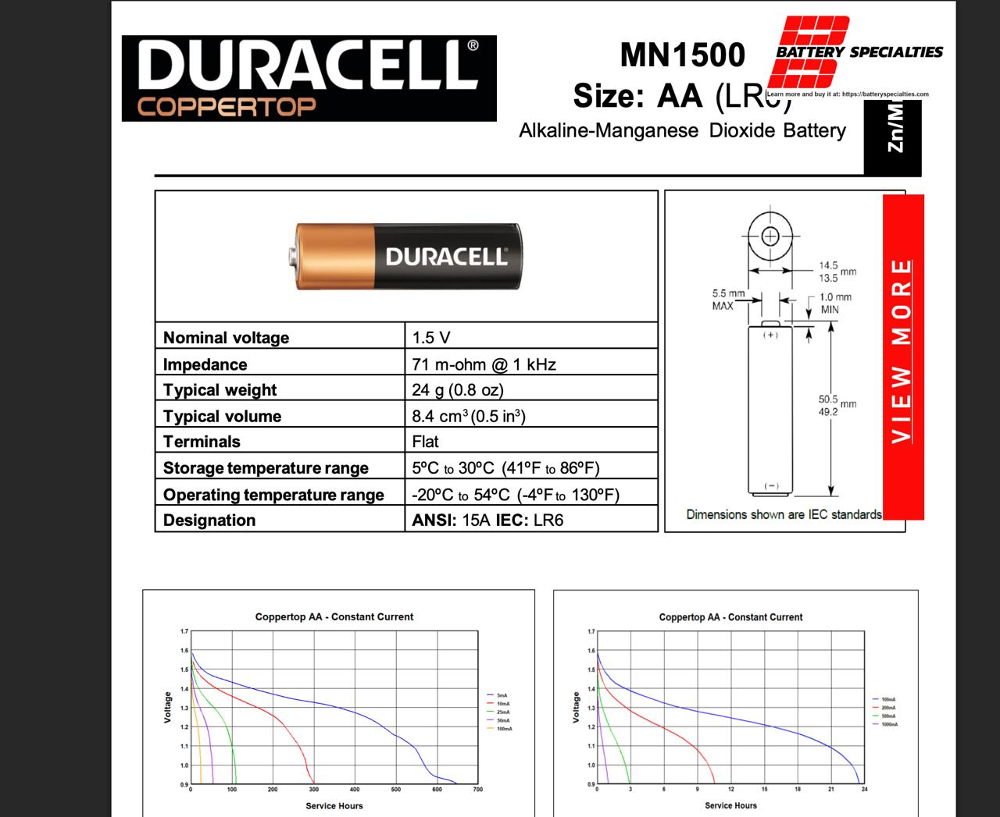

## Servo motor and Battery 

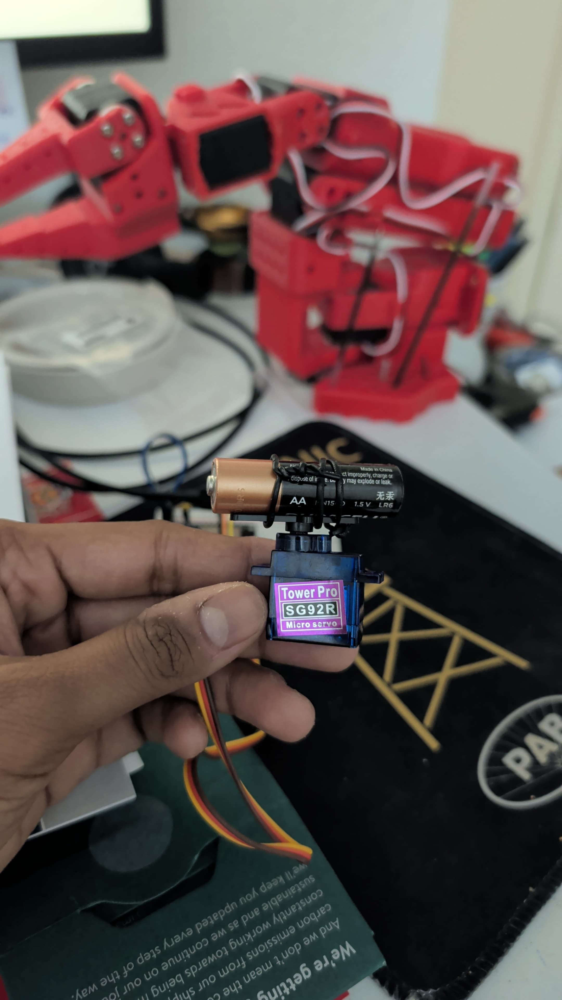

## Setup for Data Collection

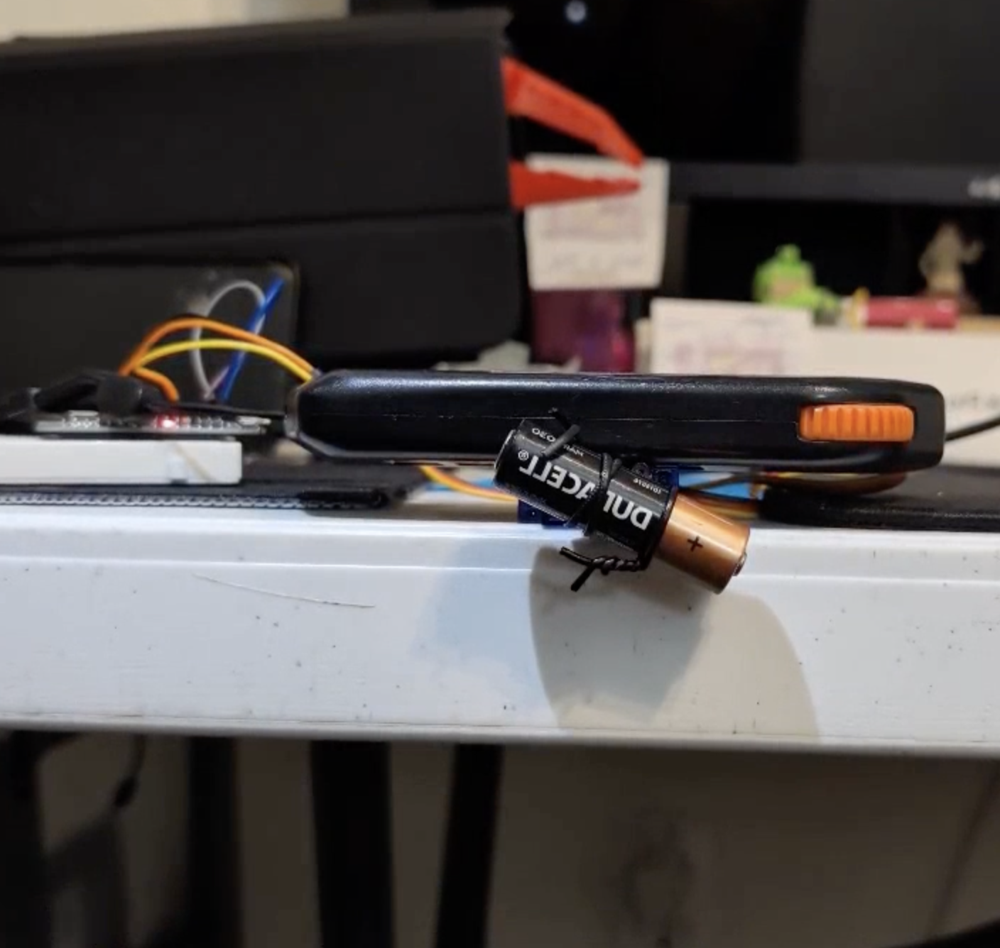

## Video Used for Data Tracking
<video controls src="motor-tracker_4EcwPMe6.mp4" title="Title"></video>

## Model Chosen & Rationale

* Plant. 1-DOF hinge with lumped inertia of the “battery” and viscous damping b_act
* Actuator law. DC-motor + gear train

## Objective. Minimize angle RMSE between simulated and measured angles on the data time grid:

* Algorithm. scipy.optimize.least_squares on variables [Kp, b_act] with bounds; simulation re-run per evaluation; sim angles interpolated to t_data.

Units. Fit in radians; report RMSE in degrees.

In [30]:

import pandas
import scipy.signal as ss
import scipy.optimize as so
import numpy
import matplotlib.pyplot as plt
import math

data = pandas.read_csv('/Users/vamshin24/Downloads/data_tracker.csv')
data.columns

Index(['t', 'x', 'y', 'x.1', 'y.1'], dtype='object')

In [31]:
t = data['t']

## Findind the centre of rotation

In [32]:
xini = data['x'].mean()
yini = data['y'].mean()
ini = numpy.array([xini,yini])
print(ini)

[3.27817355 5.09860331]


In [33]:
def fun(guess):
# break out guess into two variables, x0 and y0
    x0,y0 = guess
    # start with zero error
    error = 0
    # sum the squared length to point 1 over all time and add to error
    error += ((data['x']-x0)**2+(data['y']-y0)**2).sum()
    # sum the squared length to point 2 over all time and add to error
    error += ((data['x.1']-x0)**2+(data['y.1']-y0)**2).sum()
    # take the square root
    error = error**.5
    # return the error
    return error

In [34]:
print(fun(ini))

733.7143807338089


In [35]:
result = so.minimize(fun,ini)
result

  message: Optimization terminated successfully.
  success: True
   status: 0
      fun: 708.7890367724505
        x: [-3.489e-01  2.009e-01]
      nit: 5
      jac: [-7.629e-06 -7.629e-06]
 hess_inv: [[ 9.051e-01 -1.281e-01]
            [-1.281e-01  8.271e-01]]
     nfev: 18
     njev: 6

(np.float64(-25.171058264005254),
 np.float64(45.66894173599475),
 np.float64(-33.60088867363819),
 np.float64(27.999111326361813))

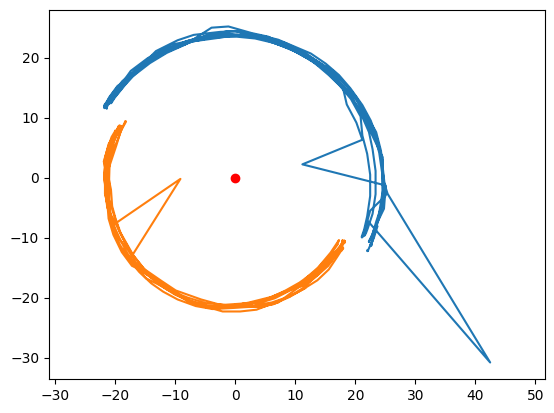

In [36]:
v1 = numpy.array([data['x']-result.x[0],(data['y']-result.x[1])]).T
v2 = numpy.array([data['x.1']-result.x[0],(data['y.1']-result.x[1])]).T


plt.plot(v1[:,0],v1[:,1])
plt.plot(v2[:,0],v2[:,1])
plt.plot(0,0,'ro')
plt.axis('equal')


## The angle of each vector can be computed by taking the arctan of the x and y components of vector 1 and 2. 

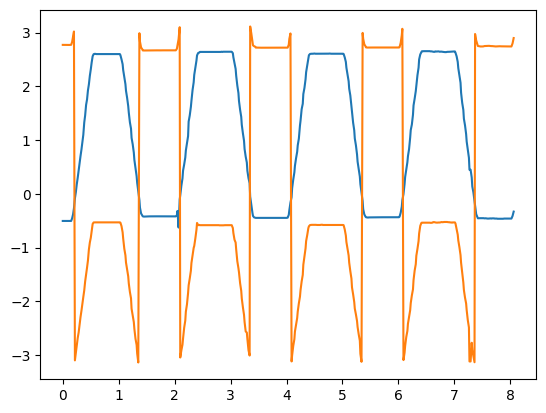

In [37]:
theta_v1 = numpy.arctan2(v1[:,1],v1[:,0])
theta_v2 = numpy.arctan2(v2[:,1],v2[:,0])
plt.plot(t,theta_v1)
plt.plot(t,theta_v2)

## Building unwrap function -- Any value that jumps more than ᅺ between individual timesteps by the arctan2 function can be interpreted to actually be continuously increasing (or decreasing) past that value.

In [38]:

def unwrap(theta,period):
#create a holder for our new theta measurement, theta2, and seed it with the initial value of theta.
    theta2 = [theta[0]]
    #we need to compare our current theta measurement against the previous one. thus, we store the init
    last_theta = theta[0]
    #create a holder for the number of times we have transitioned through another period
    mem = 0
    # Starting at our 2nd data point(index 1)
    for t_ii,item in zip(t[1:],theta[1:]):
    #compare our current theta against the last theta
        dt = (item - last_theta)
        #check if there is a big jump in the positive or negative direction, and if there is, subtract o
        if dt>(period/2):
            mem-=period
        if dt<(-period/2):
            mem+=period
        # compute the corrected value of theta and add to theta2
        theta2.append(item+mem)
        # update last_theta
        last_theta = item
        # reform theta2 as a numpy array
# and return it
    theta2 = numpy.array(theta2)
    return theta2

In [ ]:
theta_v1_u = unwrap(theta_v1,2*math.pi)
theta_v2_u = unwrap(theta_v2,2*math.pi)

In [40]:
theta_v1_u-=theta_v1_u.min()
theta_v2_u-=theta_v2_u.min()

# offset = min(theta_v1_u.min(), theta_v2_u.min())
# theta_v1_u -= offset
# theta_v2_u -= offset

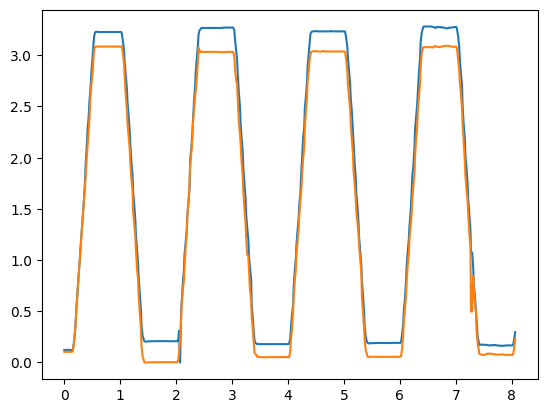

In [41]:
plt.plot(t, theta_v1_u)
plt.plot(t, theta_v2_u)

## Compute average of these 2 samples

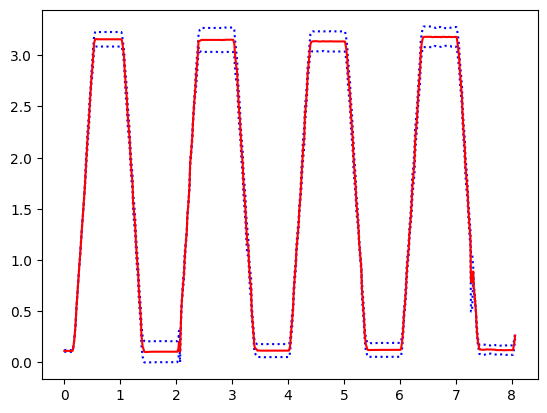

In [42]:
theta_u = (theta_v1_u+theta_v2_u)/2
plt.plot(t,theta_v1_u,'b:')
plt.plot(t,theta_v2_u,'b:')
plt.plot(t,theta_u,'r-')

In [43]:
value = numpy.nanmax(theta_u) * 180 / math.pi
print(value)


182.2804197434021


## Guessing the input signal

In [44]:
time_filter = t<1

In [45]:
jj = theta_u[time_filter] > \
(theta_u[time_filter].max() - theta_u[time_filter].min())*.01 \
+ theta_u[time_filter].min()
t_0_kk = (t[time_filter][jj]).idxmin()
t_0 = t[t_0_kk]
t_0

np.float64(0.167)

## plot the moment motion starts on top of the adjusted theta values:

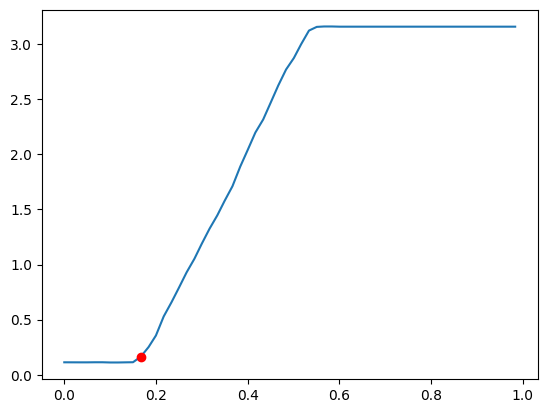

In [46]:
plt.plot(t[time_filter],theta_u[time_filter])
plt.plot(t[t_0_kk],theta_u[t_0_kk],'ro')

### Lets create a function that can generate a step function with the following parameters
• A : amplitude
• f : frequency
• w : width (as a fraction of the full time step) of the positive portion of the square wave
• b : y-offset

In [47]:
A = math.pi
f = .5
w = .5
b = 0
def square(t,A,f,w,b,t_0):
    y = (t-t_0)*f
    y = y%1
    y = (y<w)*1
    y = A*y +b
    return y

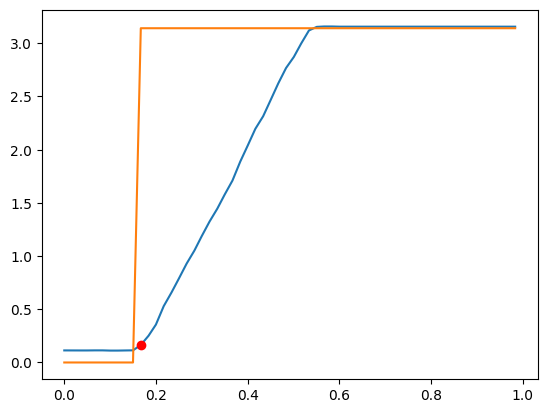

In [48]:
y = square(t,A,f,w,b,t_0)
plt.plot(t[time_filter],theta_u[time_filter])
plt.plot(t[time_filter],y[time_filter])
plt.plot(t[t_0_kk],theta_u[t_0_kk],'ro')

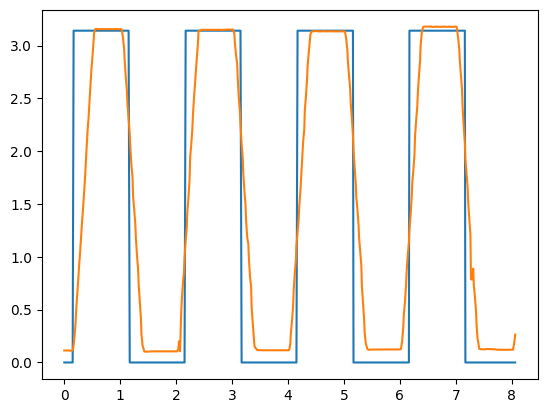

In [49]:
plt.plot(t,y)
plt.plot(t,theta_u)

## Saving the data

In [50]:
data = {}
data['A'] = A
data['f'] = f
data['b'] = b
data['w'] = w
data['t'] = t
data['t_0'] = t_0
data['theta_u'] = theta_u
import yaml
with open('servo_data_collection.yml','w') as f:
    yaml.dump(data,f)

### MuJoCo Based Model

In [51]:
import matplotlib.pyplot as plt
import numpy
import math
import yaml
import mujoco
import numpy
import mediapy as media

In [52]:
def square(t,A,f,w,b,t_0):
    y = (t-t_0)*f
    y = y%1
    y = (y<w)*1
    y = A*y +b
    return y

## Motor modeling

In [53]:
Vnom = 6
G = 55.5
t_stall = 15/100/G
i_stall = .6
R = Vnom/i_stall
i_nl = .2
w_nl = .66*1000*math.pi/180*G
kt = t_stall/ i_stall
kv= Vnom/w_nl
ke = kt
b = kt*i_nl/w_nl
ts = 1e-4

In [54]:

with open('servo_data_collection.yml') as f:
    servo_data = yaml.load(f,Loader=yaml.Loader)

In [55]:

t_data  = numpy.asarray(servo_data['t'], dtype=float).ravel()    
t_data.shape

(484,)

In [56]:
dt_data = (t_data[-1]-t_data[0])/len(t_data)

In [57]:
q_data = numpy.asarray(servo_data['theta_u'], dtype=float).ravel().T
q_data.shape

(484,)

In [58]:
desired = square(t_data,A=servo_data['A'],
f = servo_data['f'],w=servo_data['w'],
b=servo_data['b'],t_0=servo_data['t_0'])

## Building the body of battery (length: 50.50mm, width = 14.5mm, weight = 0.024kg)

In [59]:
render_width = 800
render_height = 600
xml_template = """
<mujoco>
    <visual><global offwidth="{render_width}" offheight="{render_height}" /></visual>
    <option timestep="{ts}"/>
    <worldbody>
        <light name="top" pos="0 0 10"/>
        <body name="body_1" pos="0 0 0" axisangle="1 0 0 0">
            <joint name="joint_1" type="hinge" axis="1 0 0" pos="0 0 0"/>
            <geom type="cylinder" size=".00725 .025" pos="0 0 0" rgba="0 1 1 1"
                mass="0.024"/>
            <geom type="cylinder" size=".0025 .0025" pos="0 0 .024" rgba="0 1 1 1"
                mass="0"/>
        </body>
    </worldbody>
<actuator>
    <motor name="motor_1" joint="joint_1"/>
</actuator>
</mujoco>
"""


In [60]:
xml = xml_template.format(ts = ts, render_width = render_width, render_height = render_width)

In [61]:
model = mujoco.MjModel.from_xml_string(xml)
data = mujoco.MjData(model)
renderer = mujoco.Renderer(model,width=render_width,height=render_height)
duration = t_data[-1] # (seconds)
framerate = 30 # (Hz)
data_rate = 1/dt_data
print(duration,data_rate)

8.06 60.04962779156327


### function that generates a controller callback function and runs the simulation, returning the time vector and position vector for joint_1 .

In [62]:
import numpy as np
def run_sim(kp, b_act, render=False, video_filename=None):
    V_supply = 5.0

    def mycontroller1(model, data):
        # PD-like motor model -> torque
        w = data.qvel[0]                               # joint speed
        actual = data.qpos[0]                          # joint angle
        t = data.time
        desired = square(t,
                         A=servo_data['A'],
                         f=servo_data['f'],
                         w=servo_data['w'],
                         b=servo_data['b'],
                         t_0=servo_data['t_0'])
        error = desired - actual
        V = kp * error
        # saturate to supply
        V = max(-V_supply, min(V_supply, V))
        # simple DC motor back-EMF + viscous load (all in joint space)
        torque = (kt * (V - ke * w * G) / R - b_act * w * G) * G
        data.ctrl[0] = torque

    frames = []
    qs, ws, ts = [], [], []

    # --- initialize state ---
    mujoco.mj_resetData(model, data)

    # register controller once
    mujoco.set_mjcb_control(mycontroller1)
    try:
        while data.time < duration:
            mujoco.mj_step(model, data)

            # record state at data_rate
            if len(ts) < data.time * data_rate:
                ts.append(data.time)
                qs.append(data.qpos.copy())
                ws.append(data.qvel.copy())

            # grab frames at framerate
            if render and len(frames) < data.time * framerate:
                renderer.update_scene(data)
                pixels = renderer.render()             # HxWx3 uint8
                frames.append(pixels)
    finally:
        # ALWAYS clear the callback
        mujoco.set_mjcb_control(None)

    # numpy-ify after loop
    ts = np.asarray(ts)
    qs = np.asarray(qs)
    ws = np.asarray(ws)

    # write video ONCE after loop
    if render and video_filename is not None:
        # Try H.264 first; if your ffmpeg lacks the proper encoder/flags, fall back to webm
        try:
            media.show_video(frames, fps = framerate,codec='gif')
        except RuntimeError as e:
            print("H.264 encode failed, falling back to WebM (VP9). Error:", e)
            alt_name = video_filename.rsplit('.', 1)[0] + '.webm'
            media.show_video(frames, fps = framerate,codec='gif')
            video_filename = alt_name

    return np.asarray(ts), np.asarray(qs), frames if render else []


## For Kp = 15

""

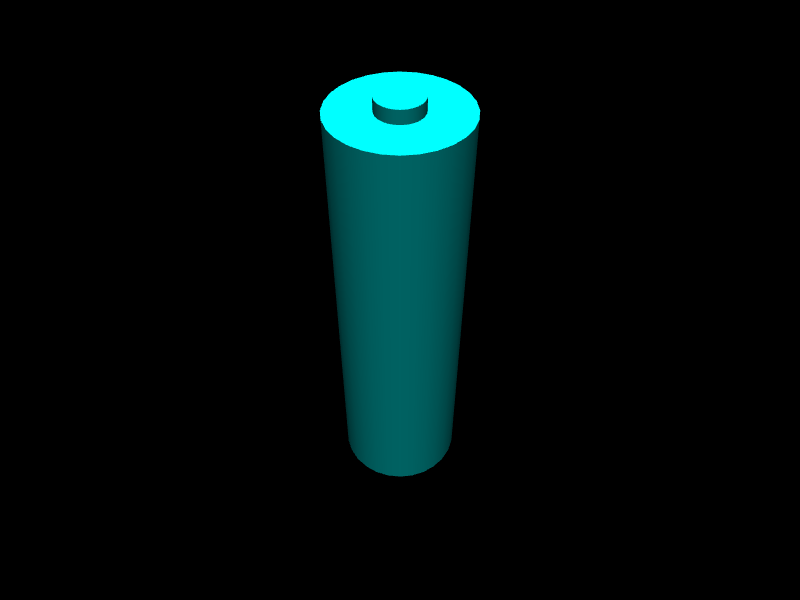

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

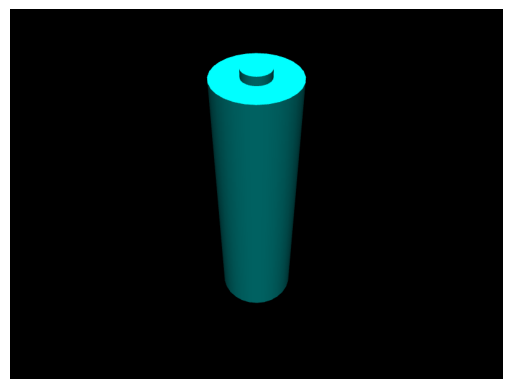

In [63]:
t, q, frames = run_sim(kp=15, b_act=b, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')

t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


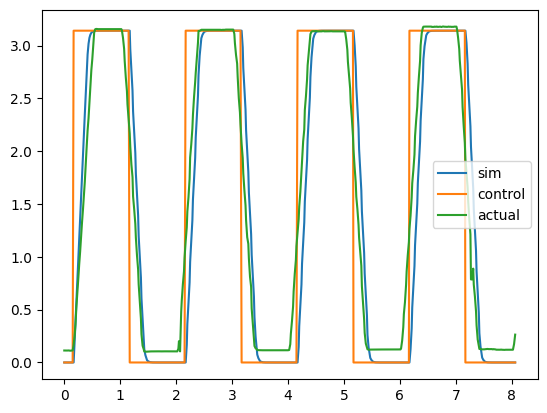

In [64]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()

## Model vs Data Plot

### Figure contents:
* – Control (desired): square-wave command;
* – Actual (data): reconstructed angle;
* – Sim: model output with fitted parameters.

* Style. Labeled axes (time [s], angle [rad]), distinct linestyles/colors, legend, and title “Servo Tracking: Data vs Model”.





## For Kp = 1 and dampening is b*0.2

In [65]:
import scipy.optimize as so
def fun(vars):
    k,b = vars
    t, q, frames = run_sim(kp=k, b_act=b, render=True, video_filename='output1.mp4')
    error = q-q_data
    
    error = error**2
    error = error.sum()
    error = error**.5
    print(k,b,error)
    return int(round(error))

# def residuals(vars_):
#     kp = float(vars_[0])
#     b_act = float(vars_[1])

#     # unpack what run_sim returns (if it returns 3 values)
#     t, q, _ = run_sim(kp=kp, b_act=b_act, render=False)

#     # --- align to reference ---
#     t_ref = np.asarray(t_data).ravel()
#     q_ref = np.asarray(q_data).ravel()
#     t_sim = np.asarray(t).ravel()
#     q_sim = np.asarray(q).ravel()
#     q_sim_on_ref = np.interp(t_ref, t_sim, q_sim)
#     e = q_sim_on_ref - q_ref
#     e = np.arctan2(np.sin(e), np.cos(e))   # wrap

#     return e

""

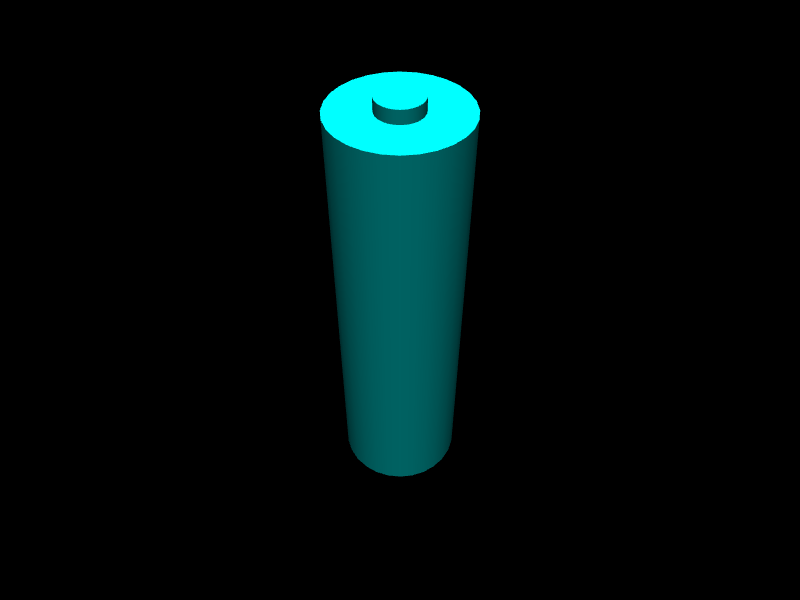

1 2.8183357565468333e-07 827.7192746752488


828

In [66]:
ini = [1,b*0.2]
fun(ini)

# # initial guess (kp, b_act)
# x0 = np.array([15.0, float(b)])

# # bounds are optional; adjust if needed
# res = so.least_squares(residuals, x0, bounds=([0.0, 0.0], [200.0, 5.0]))
# kp_fit, b_fit = res.x
# rmse_deg = np.degrees(np.sqrt(np.mean(res.fun**2)))
# print("kp:", kp_fit, " b_act:", b_fit, "  RMSE(deg):", rmse_deg)

## For above and below case I used Kp = 1 and dampening b*0.2 --- I'm considering this as my ideal and closest according to graph

""

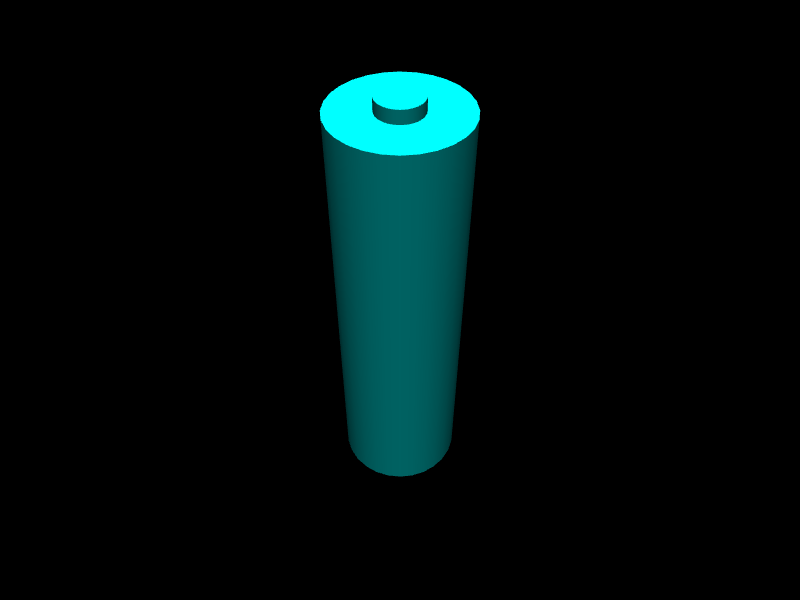

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

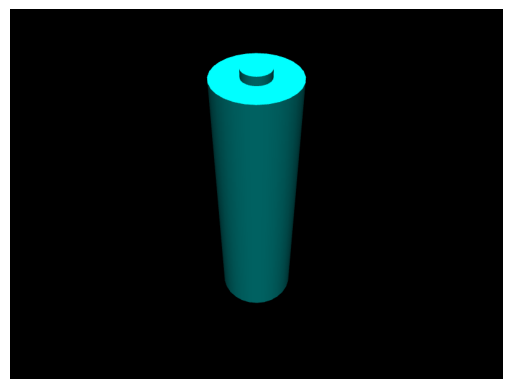

In [84]:
t, q, frames = run_sim(kp=15, b_act=b*0.2, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')


t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


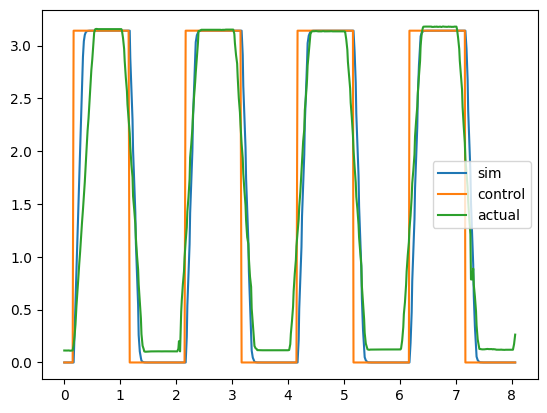

In [83]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()

### The fitted model reproduces step transitions reasonably well and yields updated motor constants (W_nl, i_nl, k_v) consistent with the identified damping, improving steady-state speed and power predictions for the team’s full dynamic model.

### Start‐point correction (make the curves start at (0,0))

**Problem.** The data trace begins with an angle/time offset, so the first sample is not at (0 s, 0 rad).

1) **Time zeroing:** shift time so the first sample is 0  
   `t_data = t_data - t_data[0]`
2) **Angle zeroing:** subtract the first measured angle (or the mean of the first 100 ms)  
   `q_data = q_data - q_data[0]` 
   Also zero the sim’s initial condition: set `data.qpos[:] = q_data[0]` before running.

# Parameter Identification

In [86]:
V_supply = 5
w_nl_updated = kt*V_supply/((b*0.2)*R +kt*ke)
i_nl_updated = w_nl_updated*(b*0.2)/kt
kv_updated = V_supply/w_nl_updated
print('w_nl: ',w_nl,'w_nl(updated): ',w_nl_updated)
print('i_nl: ',i_nl,'i_nl(updated): ',i_nl_updated)
print('k_v: ',kv,'k_v(updated): ',kv_updated)

w_nl:  639.3141050055228 w_nl(updated):  974.6256138668646
i_nl:  0.2 i_nl(updated):  0.06097945321312409
k_v:  0.009385058069300956 k_v(updated):  0.005130175042457902


### ω_nl = No-load angular speed (rad/s). - The motor’s steady-state speed when supplied with a given voltage and no mechanical load (only internal losses).
### i_nl = No-load current(A) - The current drawn at no mechanical load. It covers bearing/friction + windage + iron losses.
### k_v = Back EMF Constant (V.s/rad) - The constant relating motor speed to generated voltage and current to torque (in SI, K_t = K_v) 

## Discussion & Answers

### 1) What could be improved in the experiment design?
- **Time/angle zeroing:** hard-reset time to 0 and set initial angle by averaging the first 100 ms.
- **Mechanical isolation:** clamp/weight the base and use a rigid horn to reduce compliance.
- **Optics:** fix camera at normal incidence, known distance, and use a calibration square to remove scale/tilt.
- **SNR:** increase lighting and frame rate; average multiple runs.

### 2) Rationale for the chosen model (and assumptions)
- **Model:** 1-DOF hinge with a lumped inertia load; DC-motor drive with back-EMF and viscous loss
- **Why this model:** minimal parameters yet captures the dominant behavior for a hobby servo under step/square commands; fast to simulate and identifiable from our data.
- **Key assumptions / simplifications:** planar motion; constant K_t  (SI); **viscous** damping only; fixed gear ratio \(G\); no compliance; no thermal/voltage sag; gravity only.
- **References (standard):** DC motor electromechanics (back-EMF + torque constant), textbook.

### 3) Why this fitting method?
- **Method:** nonlinear **least-squares** on wrapped angle residuals.
- **Justification:** small parameter set (2–3 vars), smooth differentiable simulator, supports **bounds** and returns a covariance proxy.

### 4) Numerical & qualitative fit
- **Result (example from our run):** \(k_p=1\), (b_act approx b*0.2).
- **Qualitative:** plateaus match well; main error occurs at rising/falling edges (phase lag). Visual overlay shows sim (blue) hugging the actual (green) except around transitions.

### 5) Validity limits (where the model works)
- **Good fit when:** moderate speeds/torques, voltage not sagging, small accelerations, minimal stiction, no backlash; temperature roughly constant.
- **Expectation:** our use stays mostly inside these limits; for tasks with rapid reversals or precision near zero-velocity.


In [67]:

# results = so.minimize(fun,x0=ini,method='nelder-mead',bounds = ((1,100),(b*.1,b*10)),
# options={'xatol':1e-2,'fatol':1e-2})

In [68]:
# results

In [69]:

# kp_act, b_act =results.x
# t,q,frames = run_sim(kp_act,b_act,render=True,video_filename='output.mp4')
# plt.imshow(frames[0])
# plt.axis('off')

## Other Exxperimentations with values, For Kp = 2

""

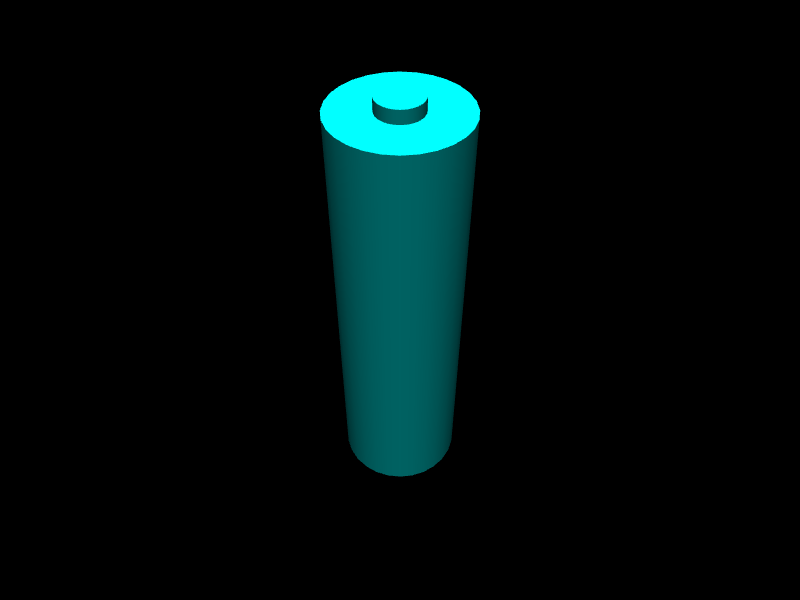

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

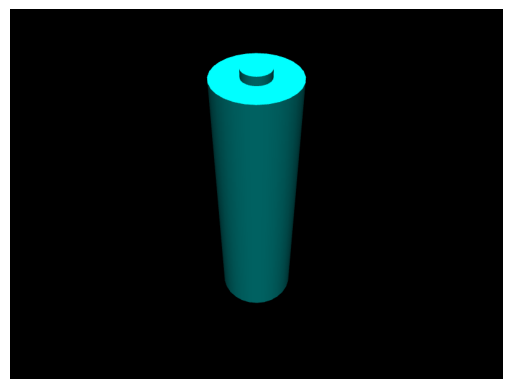

In [70]:
t, q, frames = run_sim(kp=2, b_act=b, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')

t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


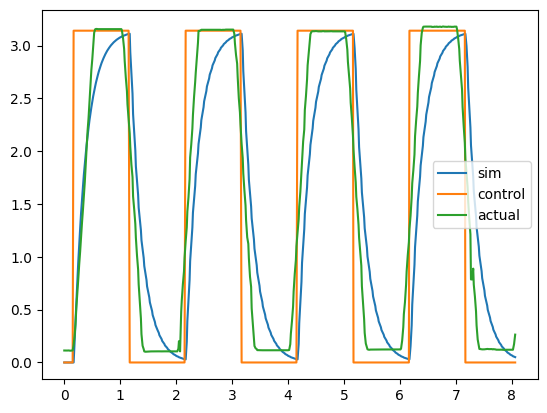

In [71]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()

In [72]:
import scipy.optimize as so
def fun(vars):
    k,b = vars
    t, q, frames = run_sim(kp=k, b_act=b, render=True, video_filename='output1.mp4')
    error = q-q_data
    error = error**2
    error = error.sum()
    error = error**.5
    print(k,b,error)
    return int(round(error))

""

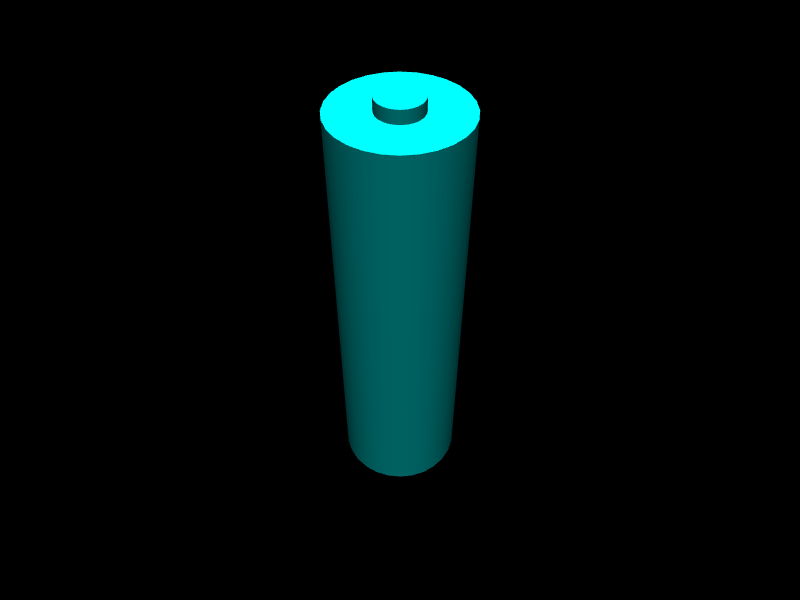

100 1.4091678782734167e-06 943.1230409838163


943

In [73]:

ini = [100,b]
fun(ini)

## Kp = 4

""

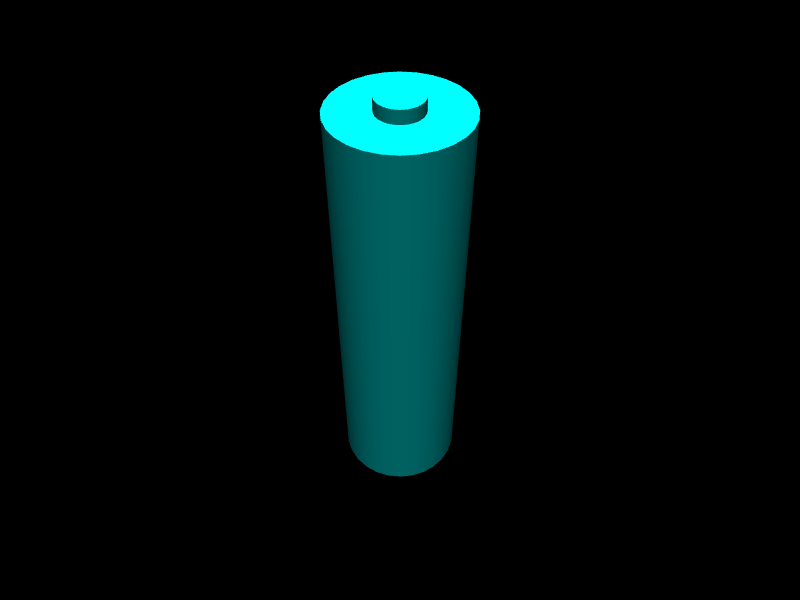

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

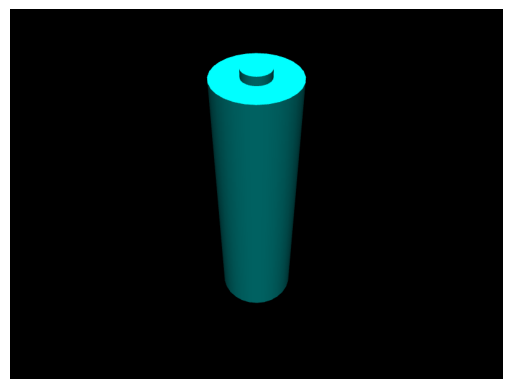

In [74]:
t, q, frames = run_sim(kp=4, b_act=b, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')

t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


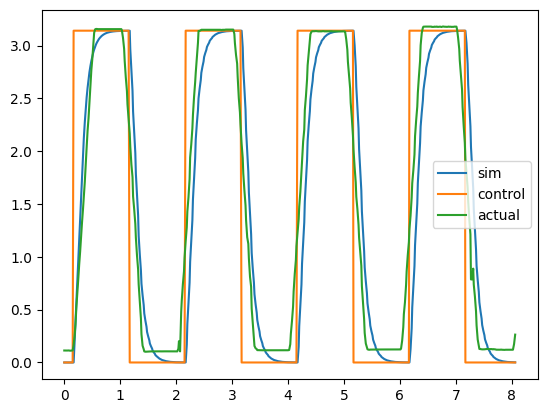

In [75]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()

## Kp = 20

""

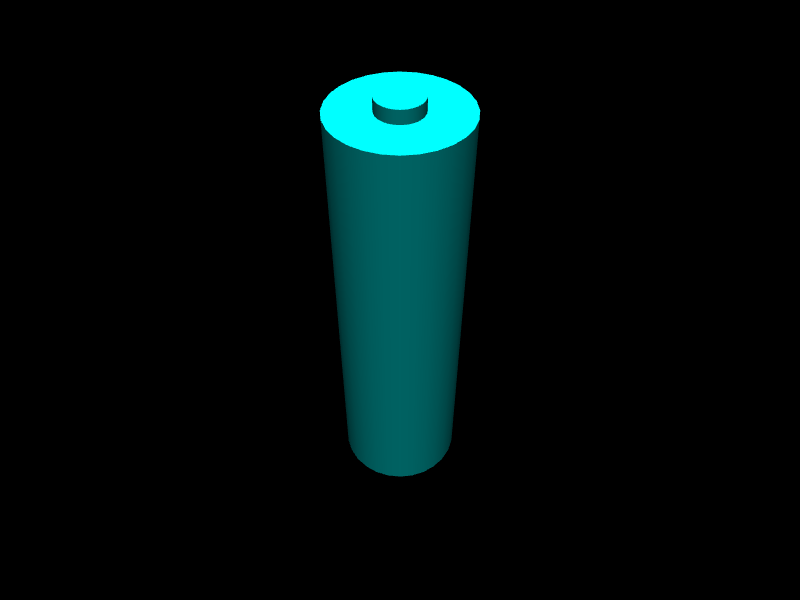

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

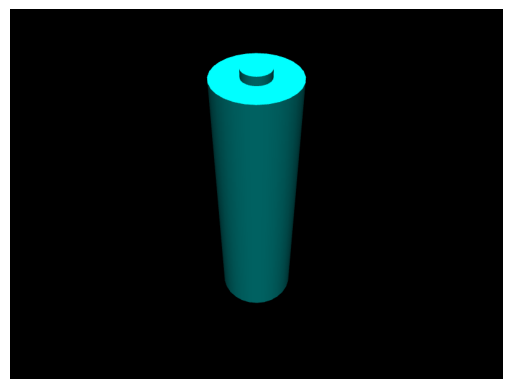

In [76]:
t, q, frames = run_sim(kp=20, b_act=b, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')

t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


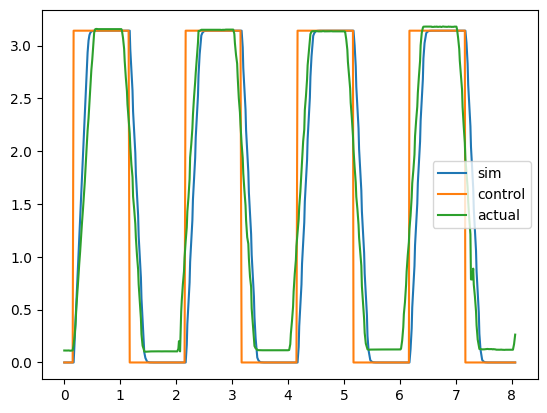

In [77]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()

## Experimenting with the dampening

""

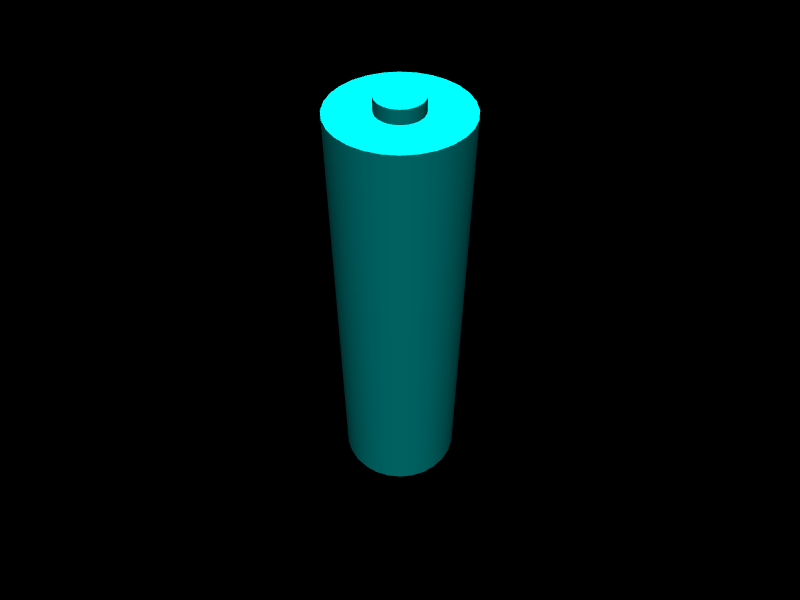

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

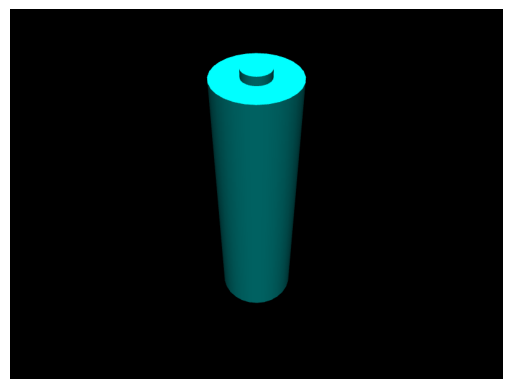

In [78]:
t, q, frames = run_sim(kp=20, b_act=b*3, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')

t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


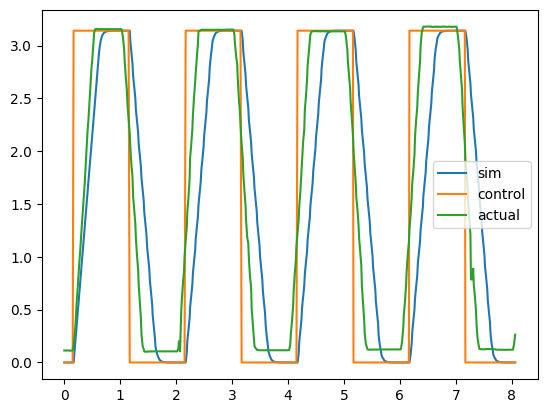

In [79]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()

""

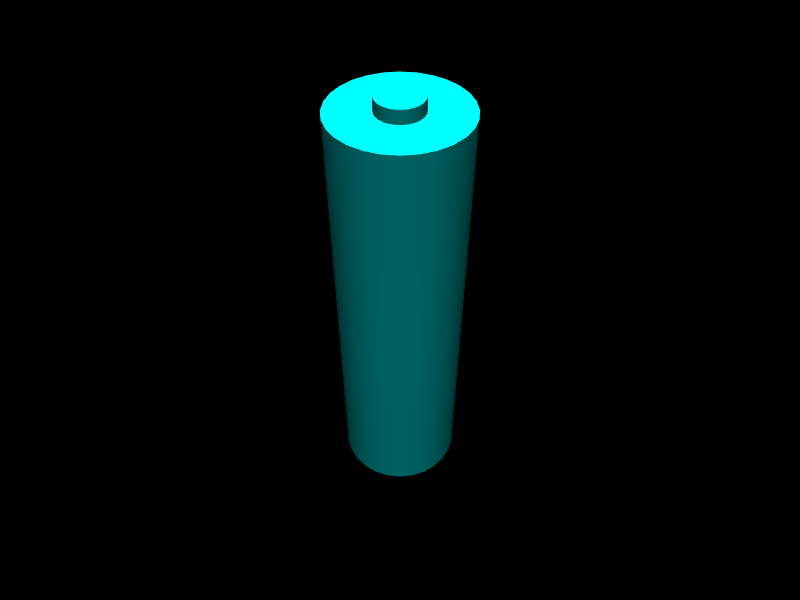

(np.float64(-0.5), np.float64(799.5), np.float64(599.5), np.float64(-0.5))

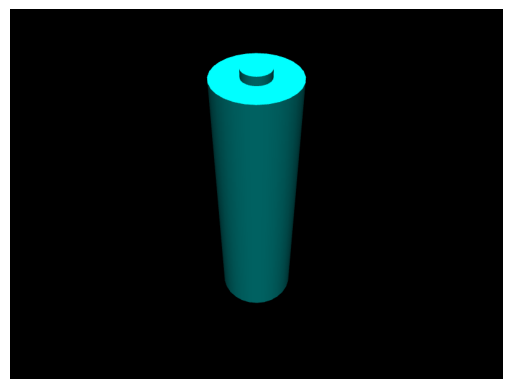

In [80]:
t, q, frames = run_sim(kp=20, b_act=b*6, render=True, video_filename='output1.mp4')
plt.imshow(frames[0])
plt.axis('off')

t_data (484,)
desired (484,)
q_data (484,)
q (485, 1)


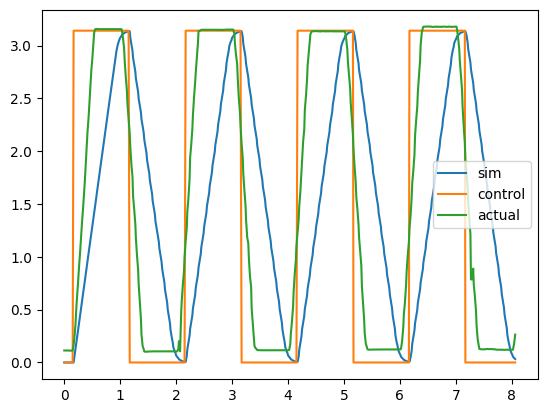

In [81]:
print('t_data', np.shape(t_data))
print('desired', np.shape(desired))
print('q_data', np.shape(q_data))
print('q', np.shape(q)) 

q_sim = np.asarray(q).ravel()[:len(t_data)]   # drop the last sample

plt.plot(t_data, q_sim,  label='sim')
plt.plot(t_data, desired,label='control')
plt.plot(t_data, q_data, label='actual')
plt.legend(); plt.show()